# InfoMax Gan Implementation for Covid19 Lung CT Scans
## Colab Link:
https://colab.research.google.com/drive/1N5mVNpTTfkj19YaoIvKiyn_a_6NilLio

***Google Drive Checkpoint Upload lines would have to be modified to suit if wanted to backup further training**

In [1]:
# Use modified fork of mimicry library for InfoMax Gan
!git clone https://github.com/justinandronicos/mimicry.git
!pip install -e /content/mimicry

import sys
sys.path.append('/content/mimicry')

# !nvidia-smi


Cloning into 'mimicry'...
remote: Enumerating objects: 35, done.
remote: Counting objects: 100% (35/35), done.
remote: Compressing objects: 100% (35/35), done.
remote: Total 1313 (delta 24), reused 0 (delta 0), pack-reused 1278
Receiving objects: 100% (1313/1313), 17.38 MiB | 38.53 MiB/s, done.
Resolving deltas: 100% (845/845), done.
Obtaining file:///content/mimicry
     |████████████████████████████████| 194kB 10.4MB/s 
     |████████████████████████████████| 235kB 10.3MB/s 
ERROR: datascience 0.10.6 has requirement coverage==3.7.1, but you'll have coverage 5.3 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
ERROR: coveralls 0.5 has requirement coverage<3.999,>=3.6, but you'll have coverage 5.3 which is incompatible.
ERROR: pytest-cov 2.10.1 has requirement pytest>=4.6, but you'll have pytest 3.6.4 which is incompatible.
  Found existing installation: coverage 3.7.1
    Uninstalling coverage-3.7.1:
  

In [ ]:
# # Mount google drive
# from google.colab import drive
# drive.mount('/content/gdrive')

# Train on all CT Scans for 30k epochs

In [2]:
# Get Covid CT Scans
!pip install gdown
from os import path
if not path.exists('/content/COVID-CT.zip'):
  !gdown --id 1JLK8gUQY124vmTO6z0RryPZt4Eg1qW4o --output COVID-CT.zip
!unzip COVID-CT

Downloading...
From: https://drive.google.com/uc?id=1JLK8gUQY124vmTO6z0RryPZt4Eg1qW4o
To: /content/COVID-CT.zip
390MB [00:11, 33.1MB/s]
Archive:  COVID-CT.zip
   creating: COVID-CT/
  inflating: __MACOSX/._COVID-CT     
  inflating: COVID-CT/.DS_Store      
  inflating: __MACOSX/COVID-CT/._.DS_Store  
   creating: COVID-CT/Images-processed/
  inflating: __MACOSX/COVID-CT/._Images-processed  
   creating: COVID-CT/baseline methods/
  inflating: __MACOSX/COVID-CT/._baseline methods  
   creating: COVID-CT/Data-split/
  inflating: __MACOSX/COVID-CT/._Data-split  
  inflating: COVID-CT/README.md      
  inflating: __MACOSX/COVID-CT/._README.md  
  inflating: COVID-CT/COVID-CT-MetaInfo.xlsx  
  inflating: __MACOSX/COVID-CT/._COVID-CT-MetaInfo.xlsx  
  inflating: COVID-CT/NonCOVID-CT-MetaInfo.csv  
  inflating: __MACOSX/COVID-CT/._NonCOVID-CT-MetaInfo.csv  
   creating: COVID-CT/Images-processed/CT_COVID/
  inflating: __MACOSX/COVID-CT/Images-processed/._CT_COVID  
  inflating: COVID-CT/Imag

In [3]:
# PATH_OF_DATA= '/content/gdrive/"My Drive"/COVID-CT/Images-processed'
PATH_OF_DATA= '/content/COVID-CT/Images-processed'
!ls {PATH_OF_DATA}

CT_COVID  CT_NonCOVID


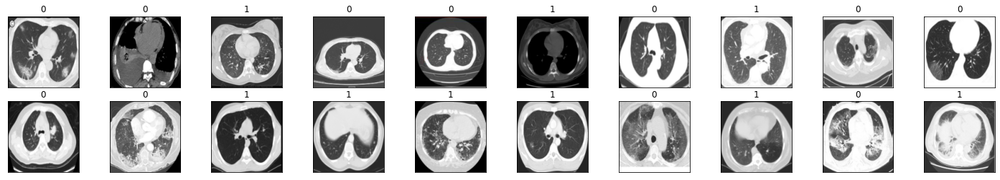

In [4]:
import torch
import torch.optim as optim
import torch_mimicry as mmc
from torch_mimicry.nets import infomax_gan
from torchvision import datasets, transforms

# Tensor transform, will use to transform data to Tensor datatype
transforms = transforms.Compose([transforms.Resize((128,128)),
                                transforms.ToTensor()])

# Data handling objects
device = torch.device('cuda:0' if torch.cuda.is_available() else "cpu")
ct_images = datasets.ImageFolder(root=PATH_OF_DATA, transform=transforms)


dataloader = torch.utils.data.DataLoader(dataset=ct_images,
                                          batch_size=64,
                                          shuffle=True,
                                          num_workers=4)

# take one batch of training images
dataiter = iter(dataloader)
images, labels = dataiter.next()

images.shape

import matplotlib.pyplot as plt
import numpy as np

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 4))
plot_size=20
for idx in np.arange(plot_size):
    ax = fig.add_subplot(2, plot_size/2, idx+1, xticks=[], yticks=[])
    ax.imshow(np.transpose(images[idx], (1, 2, 0)))
    # print out the correct label for each image
    # .item() gets the value contained in a Tensor
    ax.set_title(str(labels[idx].item()))


In [5]:
# Restore previous checkpoint (including images & summary)
from os import path
if not path.exists('/content/log'):
  !gdown --id 1Mcb_taQhyH82FAticDPZA1dDwnN7Kwu9 --output log.zip
  !unzip log.zip
  !rm log.zip
  !mv /content/InfoMax-GAN/log /content
  # !cp -r "/content/gdrive/My Drive/CITS4404 GAN/log/" "./log"

Downloading...
From: https://drive.google.com/uc?id=1Mcb_taQhyH82FAticDPZA1dDwnN7Kwu9
To: /content/log.zip
1.16GB [00:14, 77.3MB/s]
Archive:  log.zip
   creating: InfoMax-GAN/
  inflating: InfoMax-GAN/.DS_Store   
  inflating: __MACOSX/InfoMax-GAN/._.DS_Store  
  inflating: InfoMax-GAN/InfoMax Gan.ipynb  
  inflating: __MACOSX/InfoMax-GAN/._InfoMax Gan.ipynb  
   creating: InfoMax-GAN/log/
  inflating: InfoMax-GAN/log/.DS_Store  
  inflating: __MACOSX/InfoMax-GAN/log/._.DS_Store  
   creating: InfoMax-GAN/log/example/
  inflating: InfoMax-GAN/log/example/.DS_Store  
  inflating: __MACOSX/InfoMax-GAN/log/example/._.DS_Store  
   creating: InfoMax-GAN/log/example/images/
  inflating: __MACOSX/InfoMax-GAN/log/example/._images  
   creating: InfoMax-GAN/log/example/checkpoints/
  inflating: InfoMax-GAN/log/example/params.json  
  inflating: __MACOSX/InfoMax-GAN/log/example/._params.json  
   creating: InfoMax-GAN/log/example/viz/
  inflating: __MACOSX/InfoMax-GAN/log/example/._viz  
   cre

In [ ]:
# Save checkpoint/log file to drive
log_upload_path = "/content/gdrive/My Drive/CITS4404 GAN/log" 

# Define models and optimizers
netG = infomax_gan.InfoMaxGANGenerator128().to(device)
netD = infomax_gan.InfoMaxGANDiscriminator128().to(device)
optD = optim.Adam(netD.parameters(), lr=2e-4, betas=(0.0, 0.9))
optG = optim.Adam(netG.parameters(), lr=2e-4, betas=(0.0, 0.9))


# Start training
trainer = mmc.training.Trainer(
    netD=netD,
    netG=netG,
    optD=optD,
    optG=optG,
    n_dis=2,
    num_steps=100000,
    lr_decay='linear',
    dataloader=dataloader,
    log_dir='./log/example',
    vis_steps=500,
    log_steps=50,
    save_steps=2500,
    device=device)
trainer.train(log_upload_path)


Streaming output truncated to the last 5000 lines.
| errG: 1.2545
| errG_IM: 0.163
| lr_D: 0.000141
| lr_G: 0.000141
| (4.2001 sec/idx)
INFO: [Epoch 2458/8333][Global Step: 29506/100000] 
| D(G(z)): 0.2168
| D(x): 0.9509
| errD: 0.0681
| errD_IM: 0.0004
| errG: 1.2808
| errG_IM: 0.2071
| lr_D: 0.000141
| lr_G: 0.000141
| (2.2256 sec/idx)
INFO: [Epoch 2458/8333][Global Step: 29507/100000] 
| D(G(z)): 0.2106
| D(x): 0.9387
| errD: 0.1052
| errD_IM: 0.0024
| errG: 1.2431
| errG_IM: 0.1297
| lr_D: 0.000141
| lr_G: 0.000141
| (2.2094 sec/idx)
INFO: [Epoch 2459/8333][Global Step: 29508/100000] 
| D(G(z)): 0.1921
| D(x): 0.9612
| errD: 0.0338
| errD_IM: 0.0008
| errG: 1.3736
| errG_IM: 0.0918
| lr_D: 0.000141
| lr_G: 0.000141
| (2.2052 sec/idx)
INFO: [Epoch 2459/8333][Global Step: 29509/100000] 
| D(G(z)): 0.2178
| D(x): 0.9651
| errD: 0.0422
| errD_IM: 0.0001
| errG: 1.2048
| errG_IM: 0.1529
| lr_D: 0.000141
| lr_G: 0.000141
| (2.2063 sec/idx)
INFO: [Epoch 2459/8333][Global Step: 29510/10000

In [ ]:
# Update log file (checkpoint) on drive
!rsync --update -arv "./log" "/content/gdrive/My Drive/CITS4404 GAN"

sending incremental file list
log/
log/.ipynb_checkpoints/
log/example/
log/example/params.json
log/example/checkpoints/
log/example/checkpoints/netD/
log/example/checkpoints/netD/netD_10000_steps.pth
log/example/checkpoints/netD/netD_12500_steps.pth
log/example/checkpoints/netD/netD_15000_steps.pth
log/example/checkpoints/netD/netD_17500_steps.pth
log/example/checkpoints/netD/netD_20000_steps.pth
log/example/checkpoints/netD/netD_22500_steps.pth
log/example/checkpoints/netD/netD_25000_steps.pth
log/example/checkpoints/netD/netD_2500_steps.pth
log/example/checkpoints/netD/netD_27500_steps.pth
log/example/checkpoints/netD/netD_30000_steps.pth
log/example/checkpoints/netD/netD_5000_steps.pth
log/example/checkpoints/netD/netD_7500_steps.pth
log/example/checkpoints/netG/
log/example/checkpoints/netG/netG_10000_steps.pth
log/example/checkpoints/netG/netG_12500_steps.pth
log/example/checkpoints/netG/netG_15000_steps.pth
log/example/checkpoints/netG/netG_17500_steps.pth
log/example/checkpoint

In [ ]:
# !ls log/example/checkpoints/netD

netD_10000_steps.pth  netD_20000_steps.pth  netD_27500_steps.pth
netD_12500_steps.pth  netD_22500_steps.pth  netD_30000_steps.pth
netD_15000_steps.pth  netD_25000_steps.pth  netD_5000_steps.pth
netD_17500_steps.pth  netD_2500_steps.pth   netD_7500_steps.pth


In [ ]:
# Save log file (checkpoint) to drive
# !cp -r "./log" "/content/gdrive/My Drive/CITS4404 GAN"  

In [ ]:
# View plotted statistics & generated images
%load_ext tensorboard
%tensorboard --logdir ./log/example

Output hidden; open in https://colab.research.google.com to view.